<a href="https://colab.research.google.com/github/Dmytro-Tarasenko/OCRParking/blob/colab/Project_ocrparking_6.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!sudo apt install tesseract-ocr

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  tesseract-ocr-eng tesseract-ocr-osd
The following NEW packages will be installed:
  tesseract-ocr tesseract-ocr-eng tesseract-ocr-osd
0 upgraded, 3 newly installed, 0 to remove and 49 not upgraded.
Need to get 4,816 kB of archives.
After this operation, 15.6 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr-eng all 1:4.00~git30-7274cfa-1.1 [1,591 kB]
Get:2 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr-osd all 1:4.00~git30-7274cfa-1.1 [2,990 kB]
Get:3 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr amd64 4.1.1-2.1build1 [236 kB]
Fetched 4,816 kB in 1s (5,099 kB/s)
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debc

In [ ]:
!pip install pytesseract

In [ ]:
import numpy as np
import pytesseract
import torch
import cv2
from PIL import Image
from google.colab.patches import cv2_imshow
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Шлях до моделі на Google Диску
model_path = '/content/drive/MyDrive/Colab Notebooks/Project model YOLOv5/best.pt'

In [ ]:
# Завантаження моделі
model = torch.hub.load('ultralytics/yolov5', 'custom', path=model_path, trust_repo=True)

Downloading: "https://github.com/ultralytics/yolov5/zipball/master" to /root/.cache/torch/hub/master.zip


requirements: Ultralytics requirements ['gitpython>=3.1.30', 'pillow>=10.3.0'] not found, attempting AutoUpdate...
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.3/207.3 kB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 65.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 132.3 MB/s eta 0:00:00
  Attempting uninstall: pillow
    Found existing installation: Pillow 9.4.0
    Uninstalling Pillow-9.4.0:
      Successfully uninstalled Pillow-9.4.0

requirements: AutoUpdate success ✅ 5.5s, installed 2 packages: ['gitpython>=3.1.30', 'pillow>=10.3.0']
requirements: ⚠️ Restart runtime or rerun command for updates to take effect



YOLOv5 🚀 2024-9-11 Python-3.10.12 torch-2.4.0+cu121 CPU

Fusing layers... 
Model summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
Adding AutoShape... 


In [ ]:
def detect_license_plates(image):
    results = model(image)

    boxes = results.xyxy[0].cpu().numpy()
    best_confidence = -1
    best_box = None

    for box in boxes:
        x1, y1, x2, y2 = map(int, box[:4])
        confidence = box[4]

        if confidence > best_confidence:
            best_confidence = confidence
            best_box = (x1, y1, x2, y2)

    return best_box

In [ ]:
def extract_license_plate(image, best_box):
    if best_box is not None:
        x1, y1, x2, y2 = best_box
        best_license_plate = image[y1:y2, x1:x2]
        return best_license_plate
    else:
        print("Помилка: не вдалося виявити номерний знак.")
        return None

In [ ]:
def recognize_text(image):
    config = '--psm 6 --oem 3 -l eng'
    full_text = pytesseract.image_to_string(image, config=config)
    num = ''.join([i for i in full_text if i.isdigit() or i.isalpha()])
    return num

In [ ]:
def det_and_rec_license_plate(image):
    best_box = detect_license_plates(image)
    best_license_plate = extract_license_plate(image, best_box)

    if best_license_plate is not None:
        recognized_text = recognize_text(best_license_plate)
        return recognized_text
    else:
        return None

In [ ]:
image_path = '/content/drive/MyDrive/Colab Notebooks/data_car/img_0241.jpg'
image = cv2.imread(image_path)
recognized_text = det_and_rec_license_plate(image)
recognized_text

/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


'RAC0420BO'

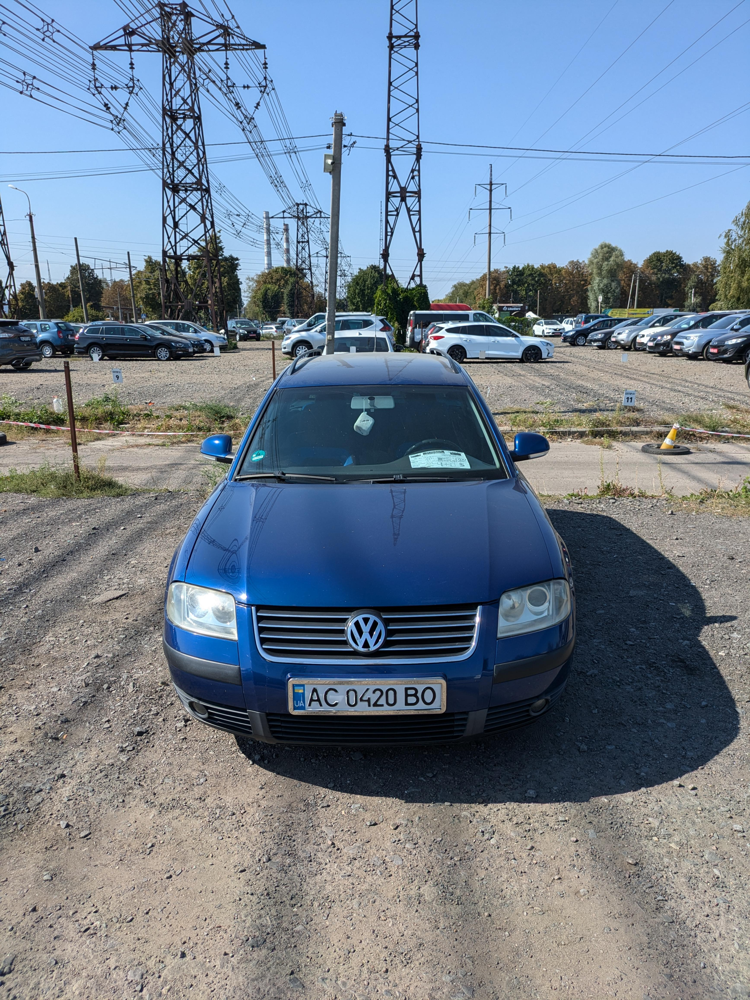

In [ ]:
cv2_imshow(image)